# Satellite Images of Water Bodies

1. Dataset<br>
A collection of water bodies images captured by the Sentinel-2 Satellite. Each image comes with a black and white mask where white represents water and black represents something else but water.<br>
Data comes from Kaggle: https://www.kaggle.com/datasets/franciscoescobar/satellite-images-of-water-bodies

2. Project<br>
The goal of this project was to use a standard U-net implementation for image segmentation, more specifically, to train the network to recognize and locate bodies of water on the image.


In [1]:
import os
import numpy as np
from tqdm import tqdm
import cv2 as cv
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from keras import Model
from keras.callbacks import Callback
from keras.optimizers import Adam
from keras.utils import plot_model
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, Dropout

2025-01-21 15:54:55.122247: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-21 15:54:55.439660: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1737503695.585094   37630 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1737503695.622454   37630 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-21 15:54:55.924681: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

In [14]:
image_path = '../test/training/Images/'
mask_path = '../test/training/Masks/'
SIZE = 128

In [15]:
# lists of images and masks names
image_names = sorted(next(os.walk(image_path))[-1])
mask_names = sorted(next(os.walk(mask_path))[-1])

images = np.zeros(shape=(len(image_names),SIZE, SIZE, 3))
masks = np.zeros(shape=(len(image_names),SIZE, SIZE, 1))

for id in tqdm(range(len(image_names)), desc="Images"):
  path = image_path + image_names[id]
  img = np.asarray(Image.open(path)).astype('float')/255.
  img = cv.resize(img, (SIZE,SIZE), cv.INTER_AREA)
  images[id] = img

for id in tqdm(range(len(mask_names)), desc="Mask"):
  path = mask_path + mask_names[id]
  mask = np.asarray(Image.open(path)).astype('float')/255.
  mask = cv.resize(mask, (SIZE,SIZE), cv.INTER_AREA)
  masks[id] = mask[:,:,:1]

Mask: 100%|██████████| 2927/2927 [00:12<00:00, 236.06it/s] 


In [ ]:
# Plot some images and its masks
plt.figure(figsize=(10,15))
for i in range(1,11):
  plt.subplot(5,2,i)

  if i%2!=0:
    id = np.random.randint(len(images))
    plt.imshow(images[id], cmap=None)
    plt.title('Original Image')
  elif i%2==0:
    plt.imshow(masks[id].reshape(128,128), cmap='gray')
    plt.title('Mask')

plt.tight_layout()
plt.show()

In [16]:
# Train test split
images_train, images_test, mask_train, mask_test = train_test_split(images, masks, test_size=0.01)

In [18]:
print(f'Train images: {len(images_train)}')
print(f'Test images: {len(images_test)}')

Train images: 2897
Test images: 30


In [19]:
# Define U-net architecture
def unet_model(input_layer, start_neurons):
    # Contraction path
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(input_layer)
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(conv1)
    pool1 = MaxPooling2D((2, 2))(conv1)
    pool1 = Dropout(0.25)(pool1)

    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(pool1)
    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(conv2)
    pool2 = MaxPooling2D((2, 2))(conv2)
    pool2 = Dropout(0.5)(pool2)

    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(pool2)
    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(conv3)
    pool3 = MaxPooling2D((2, 2))(conv3)
    pool3 = Dropout(0.5)(pool3)

    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(pool3)
    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(conv4)
    pool4 = MaxPooling2D((2, 2))(conv4)
    pool4 = Dropout(0.5)(pool4)

    # Middle
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(pool4)
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(convm)
    
    # Expansive path
    deconv4 = Conv2DTranspose(start_neurons*8, kernel_size=(3, 3), strides=(2, 2), padding="same")(convm)
    uconv4 = concatenate([deconv4, conv4])
    uconv4 = Dropout(0.5)(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)

    deconv3 = Conv2DTranspose(start_neurons*4, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv4)
    uconv3 = concatenate([deconv3, conv3])
    uconv3 = Dropout(0.5)(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)

    deconv2 = Conv2DTranspose(start_neurons*2, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv3)
    uconv2 = concatenate([deconv2, conv2])
    uconv2 = Dropout(0.5)(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)

    deconv1 = Conv2DTranspose(start_neurons*1, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv2)
    uconv1 = concatenate([deconv1, conv1])
    uconv1 = Dropout(0.5)(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    
    # Last conv and output
    output_layer = Conv2D(1, (1,1), padding="same", activation="sigmoid")(uconv1)
    
    return output_layer

In [20]:
# Compile unet model
input_layer = Input((SIZE, SIZE, 3))
output_layer = unet_model(input_layer = input_layer, start_neurons = 16)

model = Model(input_layer, output_layer)
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

I0000 00:00:1736553321.645603    8352 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9457 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:01:00.0, compute capability: 6.1


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │        448 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │      2,320 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 64, 64,    │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 64, 64,    │          0 │ max_pooling2d[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │      4,640 │ dropout[0][0]     │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │      9,248 │ conv2d_2[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 32, 32,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 32, 32,    │          0 │ max_pooling2d_1[… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 32, 32,    │     18,496 │ dropout_1[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 32, 32,    │     36,928 │ conv2d_4[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 16, 16,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 16, 16,    │          0 │ max_pooling2d_2[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 16, 16,    │     73,856 │ dropout_2[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 16, 16,    │    147,584 │ conv2d_6[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 8, 8, 128) │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 8, 8, 128) │          0 │ max_pooling2d_3[

 Total params: 2,158,705 (8.23 MB)

 Trainable params: 2,158,705 (8.23 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
# Post Process
def mask_threshold(image, threshold=0.25):
  return image>threshold

# Callback to show progress of learning on the images after each epoch
class ShowProgress(Callback):
  def __init__(self, save=False):
    self.save = save
  def on_epoch_end(self, epoch, logs=None):
    k = np.random.randint(len(images_train))
    original_image = images_train[k][np.newaxis,...]
    predicted_mask = self.model.predict(original_image).reshape(128,128)
    proc_mask02 = mask_threshold(predicted_mask, threshold=0.2)
    proc_mask03 = mask_threshold(predicted_mask, threshold=0.3)
    proc_mask04 = mask_threshold(predicted_mask, threshold=0.4)
    proc_mask05 = mask_threshold(predicted_mask, threshold=0.5)
    mask = mask_train[k].reshape(128,128)

    plt.figure(figsize=(15,10))

    plt.subplot(1,7,1)
    plt.imshow(original_image[0]);plt.title('Orginal Image')

    plt.subplot(1,7,2)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,7,3)
    plt.imshow(mask, cmap='gray');plt.title('Orginal Mask')

    plt.subplot(1,7,4)
    plt.imshow(proc_mask02, cmap='gray');plt.title('Processed: 0.2')

    plt.subplot(1,7,5)
    plt.imshow(proc_mask03, cmap='gray');plt.title('Processed: 0.3')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask04, cmap='gray');plt.title('Processed: 0.4')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask05, cmap='gray');plt.title('Processed: 0.5')

    plt.tight_layout()
    plt.show()

Epoch 1/100


I0000 00:00:1736553333.353983    9584 service.cc:148] XLA service 0x7fab0c0016b0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1736553333.354157    9584 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce GTX 1080 Ti, Compute Capability 6.1
2025-01-10 15:55:33.432064: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1736553333.772856    9584 cuda_dnn.cc:529] Loaded cuDNN version 90300
2025-01-10 15:55:34.454859: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[32,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_con

 2/91 ━━━━━━━━━━━━━━━━━━━━ 3s 43ms/step - accuracy: 0.3293 - loss: 0.6934  

2025-01-10 15:55:42.461345: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion_4', 8 bytes spill stores, 8 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion', 8 bytes spill stores, 8 bytes spill loads

I0000 00:00:1736553342.489862    9584 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


90/91 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.5554 - loss: 0.5982

2025-01-10 15:55:46.868058: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[17,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[17,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2025-01-10 15:55:46.875371: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[17,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[17,16,128,128]{3,2,1,0}, f32[16,16,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationFor

91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step - accuracy: 0.5558 - loss: 0.5978

2025-01-10 15:55:53.011372: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion_5', 8 bytes spill stores, 8 bytes spill loads

2025-01-10 15:55:53.384746: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[30,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[30,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2025-01-10 15:55:53.398810: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{}

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 753ms/step


2025-01-10 15:55:55.725733: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[1,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[1,32,128,128]{3,2,1,0}, f32[16,32,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}


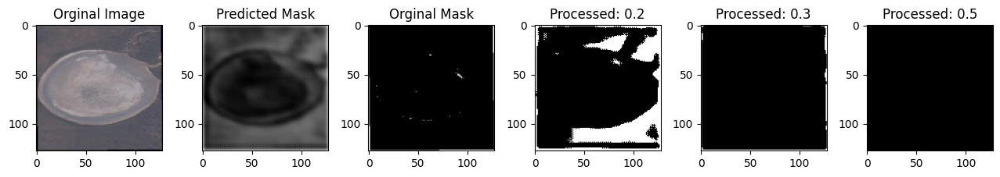

91/91 ━━━━━━━━━━━━━━━━━━━━ 25s 152ms/step - accuracy: 0.5562 - loss: 0.5973 - val_accuracy: 0.6199 - val_loss: 0.5197
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6546 - loss: 0.48


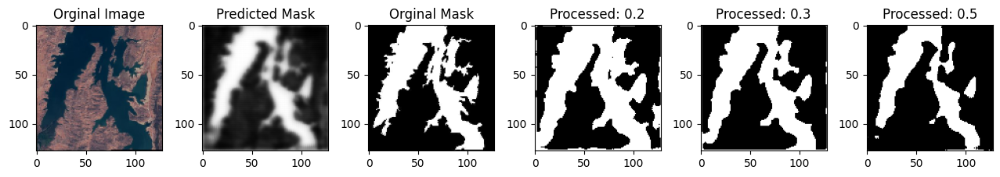

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.6545 - loss: 0.4803 - val_accuracy: 0.6541 - val_loss: 0.4695
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.6717 - loss: 0.43


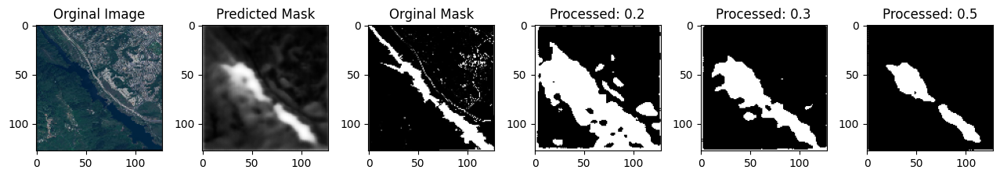

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.6718 - loss: 0.4324 - val_accuracy: 0.6768 - val_loss: 0.4005
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7053 - loss: 0.37


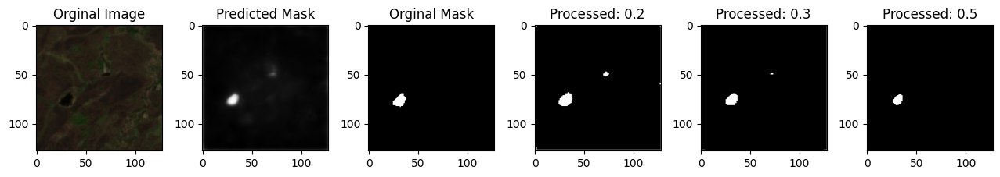

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7052 - loss: 0.3760 - val_accuracy: 0.6684 - val_loss: 0.4041
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7053 - loss: 0.36


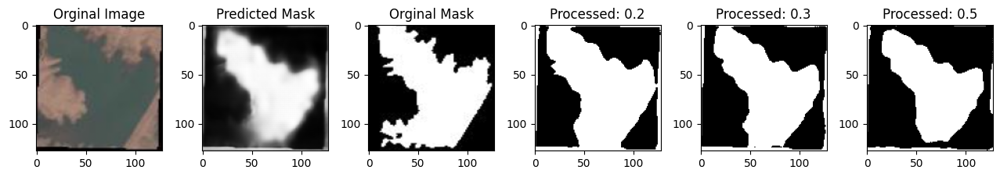

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7053 - loss: 0.3658 - val_accuracy: 0.6906 - val_loss: 0.3570
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7036 - loss: 0.35


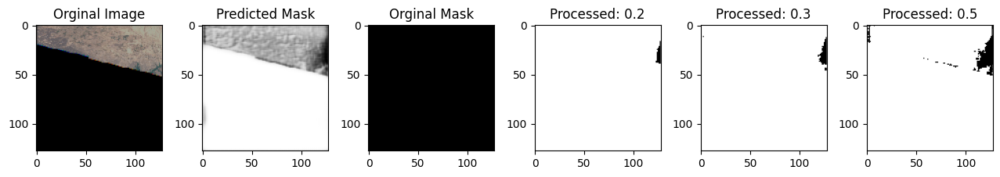

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7037 - loss: 0.3546 - val_accuracy: 0.6946 - val_loss: 0.3725
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7159 - loss: 0.33


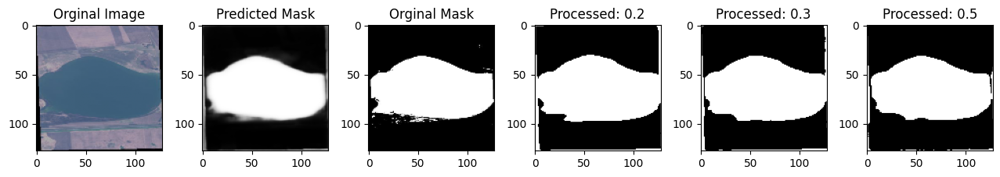

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7159 - loss: 0.3354 - val_accuracy: 0.7148 - val_loss: 0.2959
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7158 - loss: 0.32


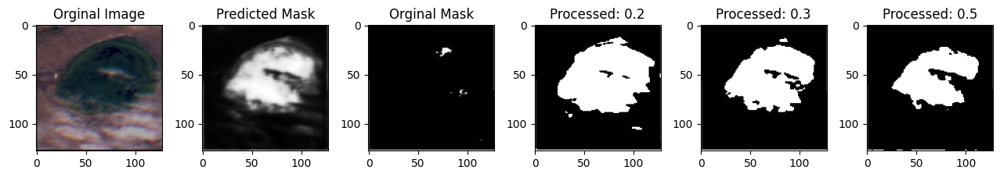

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7159 - loss: 0.3214 - val_accuracy: 0.7081 - val_loss: 0.3064
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7214 - loss: 0.31


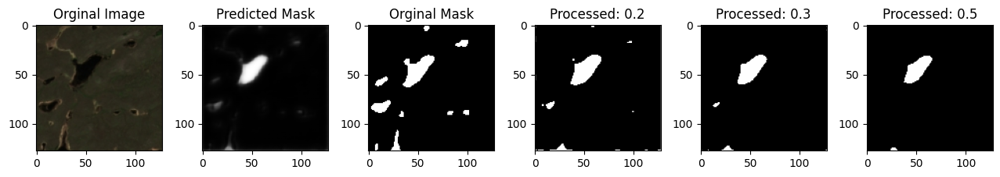

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7214 - loss: 0.3195 - val_accuracy: 0.7040 - val_loss: 0.3316
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7211 - loss: 0.31


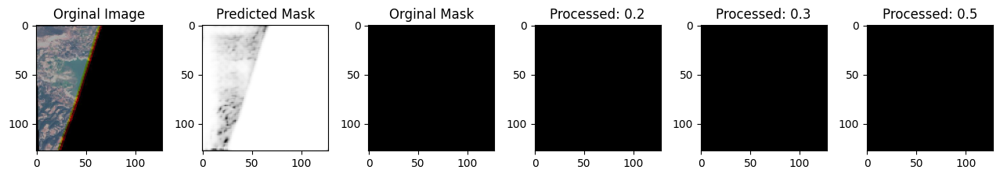

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7211 - loss: 0.3132 - val_accuracy: 0.7225 - val_loss: 0.2781
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7317 - loss: 0.29


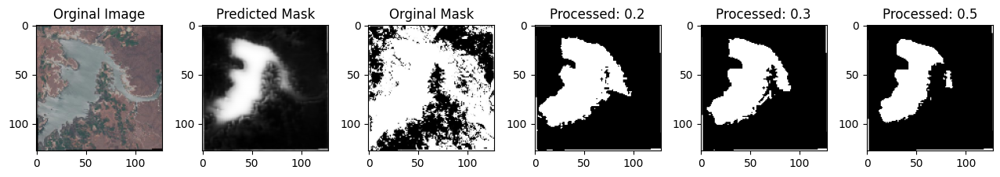

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7316 - loss: 0.2913 - val_accuracy: 0.7235 - val_loss: 0.2789
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7259 - loss: 0.29


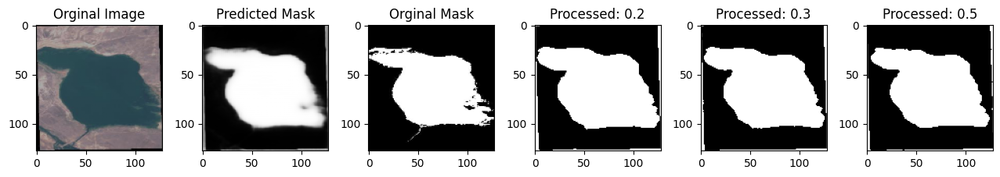

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7259 - loss: 0.2952 - val_accuracy: 0.7183 - val_loss: 0.2753
Epoch 13/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7249 - loss: 0.30


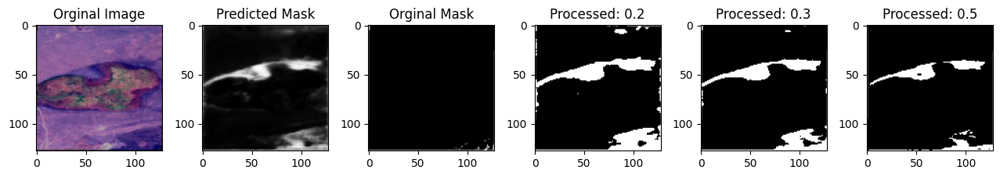

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 43ms/step - accuracy: 0.7250 - loss: 0.3022 - val_accuracy: 0.7303 - val_loss: 0.2562
Epoch 14/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7241 - loss: 0.29


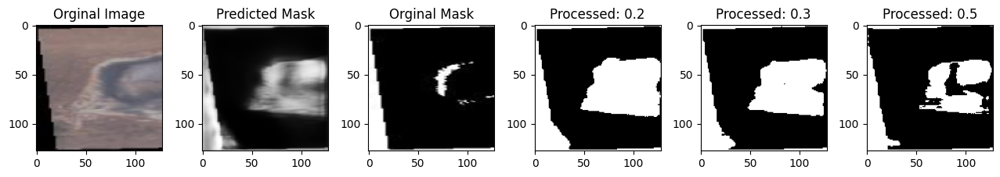

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 43ms/step - accuracy: 0.7242 - loss: 0.2988 - val_accuracy: 0.7147 - val_loss: 0.2854
Epoch 15/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7364 - loss: 0.279


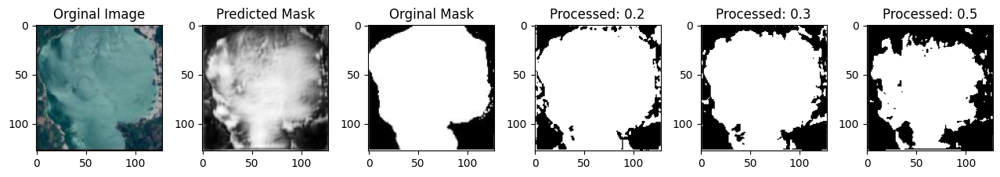

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7364 - loss: 0.2791 - val_accuracy: 0.7236 - val_loss: 0.2571
Epoch 16/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7259 - loss: 0.30


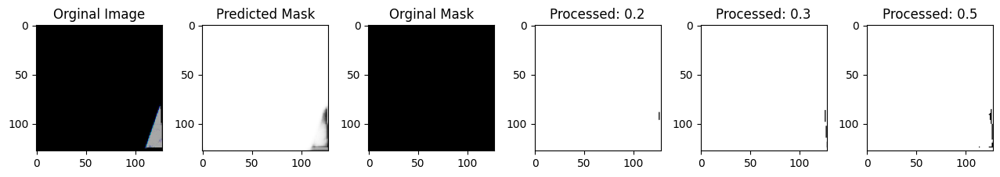

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7259 - loss: 0.3017 - val_accuracy: 0.7113 - val_loss: 0.3141
Epoch 17/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7309 - loss: 0.28


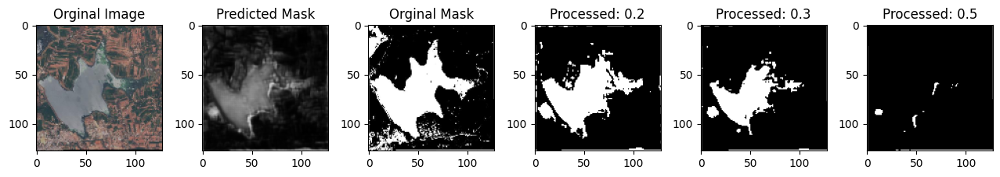

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7309 - loss: 0.2855 - val_accuracy: 0.7077 - val_loss: 0.2999
Epoch 18/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7262 - loss: 0.29


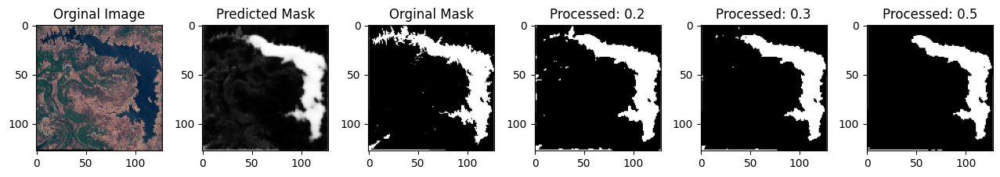

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7263 - loss: 0.2934 - val_accuracy: 0.6996 - val_loss: 0.3284
Epoch 19/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7317 - loss: 0.27


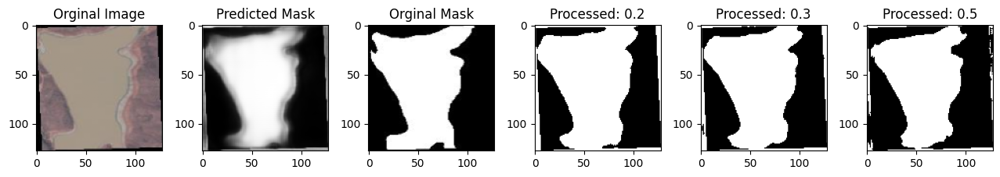

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7317 - loss: 0.2790 - val_accuracy: 0.7326 - val_loss: 0.2411
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7300 - loss: 0.28


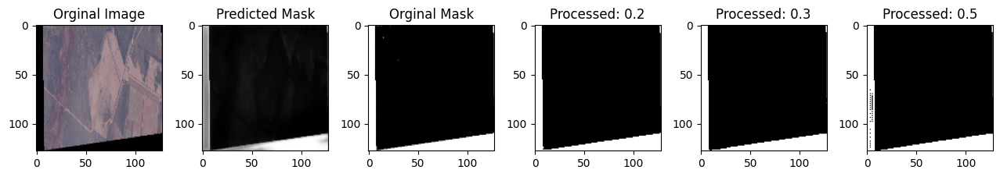

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7301 - loss: 0.2803 - val_accuracy: 0.7136 - val_loss: 0.2921
Epoch 21/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7420 - loss: 0.25


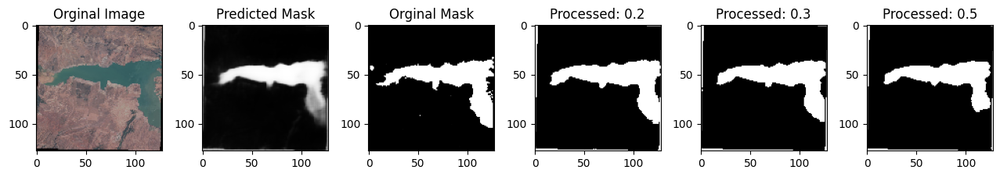

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7420 - loss: 0.2578 - val_accuracy: 0.7129 - val_loss: 0.2878
Epoch 22/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7375 - loss: 0.27


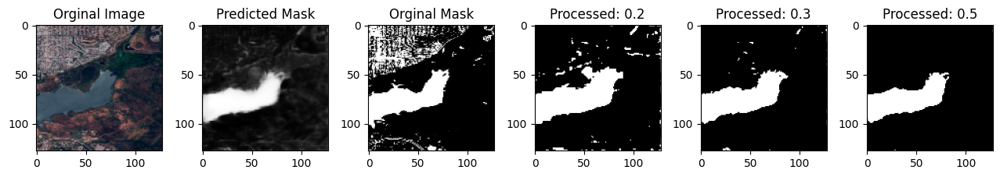

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7375 - loss: 0.2712 - val_accuracy: 0.7292 - val_loss: 0.2676
Epoch 23/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7384 - loss: 0.26


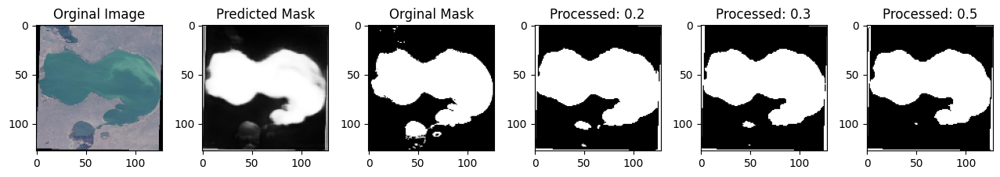

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7384 - loss: 0.2603 - val_accuracy: 0.7313 - val_loss: 0.2558
Epoch 24/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7448 - loss: 0.24


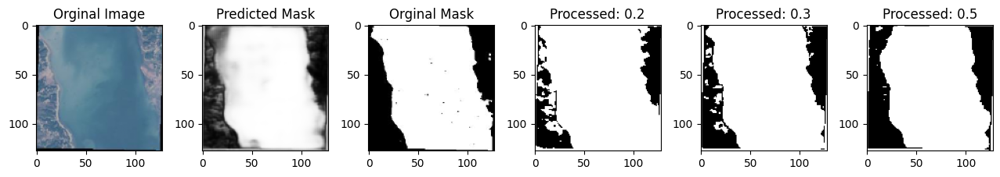

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7447 - loss: 0.2492 - val_accuracy: 0.7348 - val_loss: 0.2405
Epoch 25/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7359 - loss: 0.26


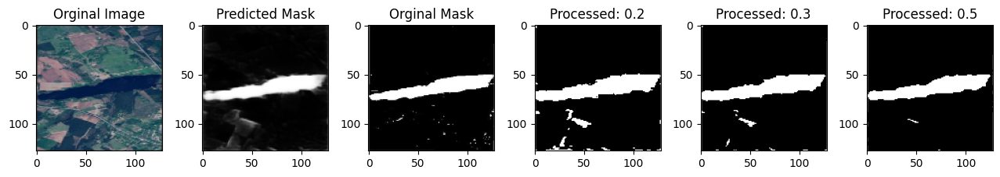

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7360 - loss: 0.2686 - val_accuracy: 0.7274 - val_loss: 0.2439
Epoch 26/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7350 - loss: 0.27


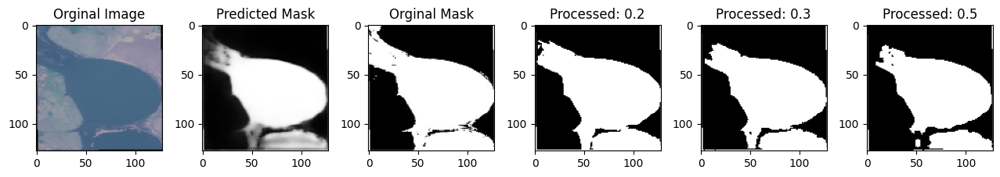

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7350 - loss: 0.2737 - val_accuracy: 0.7295 - val_loss: 0.2429
Epoch 27/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7438 - loss: 0.25


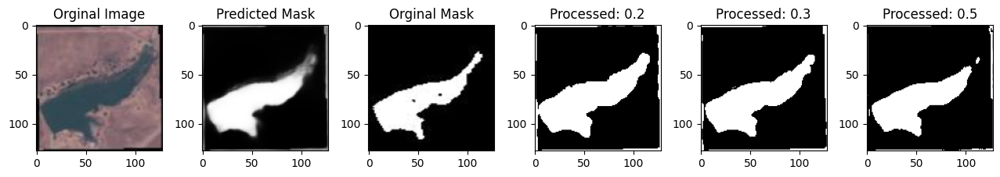

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7437 - loss: 0.2565 - val_accuracy: 0.7294 - val_loss: 0.2398
Epoch 28/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7497 - loss: 0.24


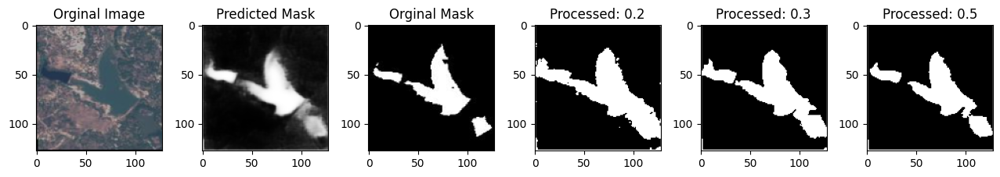

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7495 - loss: 0.2456 - val_accuracy: 0.7307 - val_loss: 0.2439
Epoch 29/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7440 - loss: 0.25


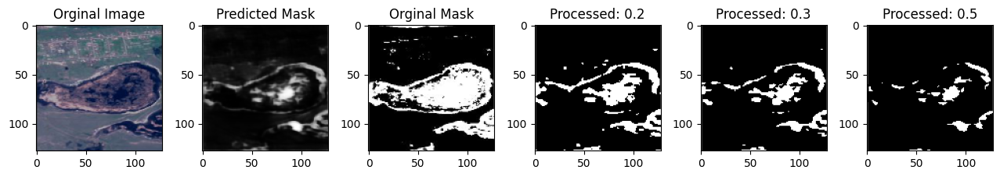

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7440 - loss: 0.2511 - val_accuracy: 0.7295 - val_loss: 0.2495
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7426 - loss: 0.25


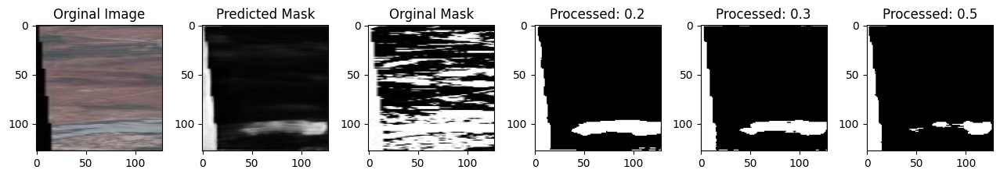

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7426 - loss: 0.2529 - val_accuracy: 0.7223 - val_loss: 0.2839
Epoch 31/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7389 - loss: 0.25


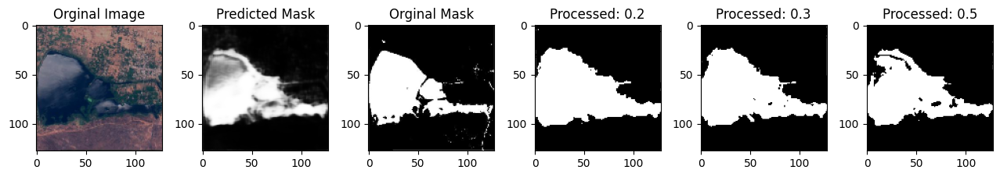

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7390 - loss: 0.2541 - val_accuracy: 0.7234 - val_loss: 0.2396
Epoch 32/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7517 - loss: 0.23


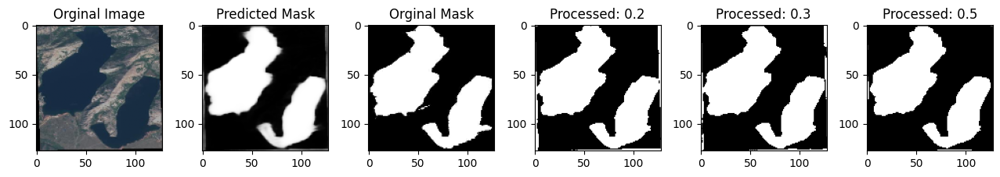

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7517 - loss: 0.2369 - val_accuracy: 0.7340 - val_loss: 0.2370
Epoch 33/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7465 - loss: 0.24


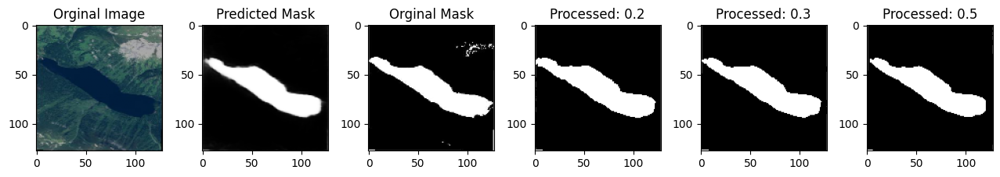

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7465 - loss: 0.2429 - val_accuracy: 0.7402 - val_loss: 0.2220
Epoch 34/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7482 - loss: 0.24


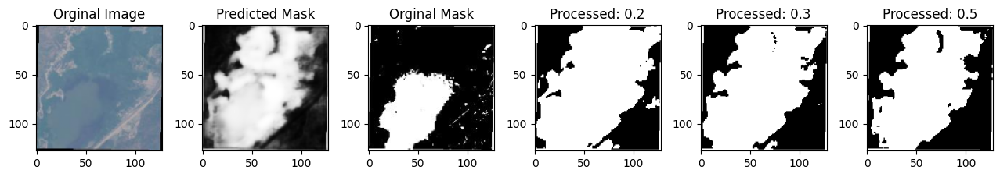

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7482 - loss: 0.2417 - val_accuracy: 0.7278 - val_loss: 0.2472
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7455 - loss: 0.24


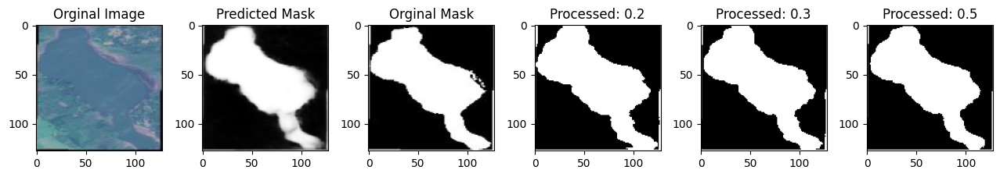

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7455 - loss: 0.2488 - val_accuracy: 0.7391 - val_loss: 0.2287
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7487 - loss: 0.24


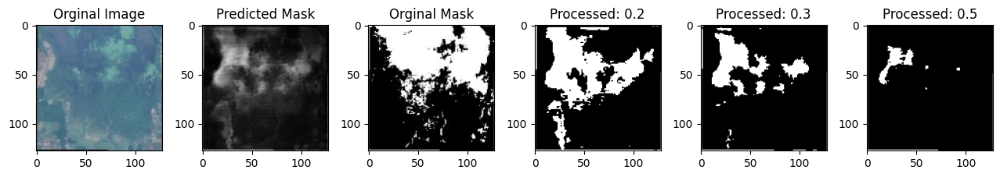

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7487 - loss: 0.2417 - val_accuracy: 0.7330 - val_loss: 0.2325
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7425 - loss: 0.24


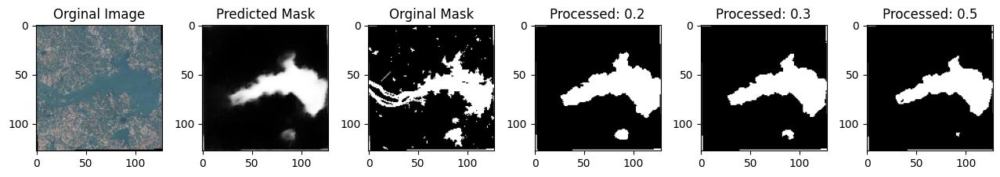

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7425 - loss: 0.2416 - val_accuracy: 0.7381 - val_loss: 0.2166
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7490 - loss: 0.23


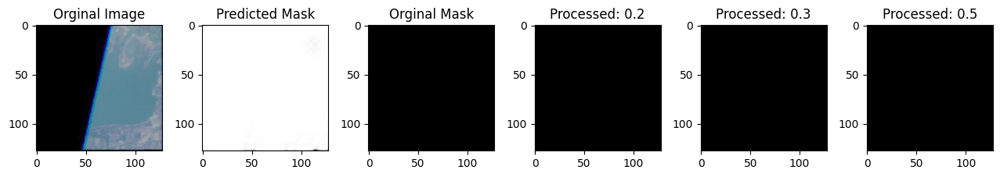

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7490 - loss: 0.2397 - val_accuracy: 0.7382 - val_loss: 0.2176
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7445 - loss: 0.24


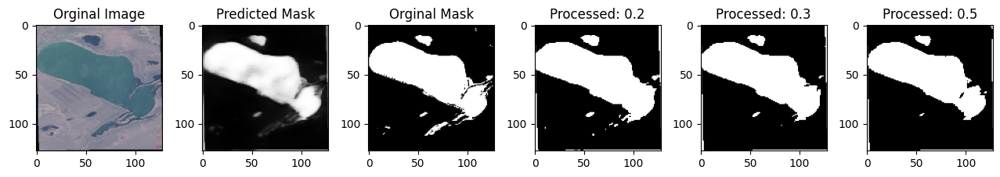

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7446 - loss: 0.2416 - val_accuracy: 0.7368 - val_loss: 0.2338
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7465 - loss: 0.22


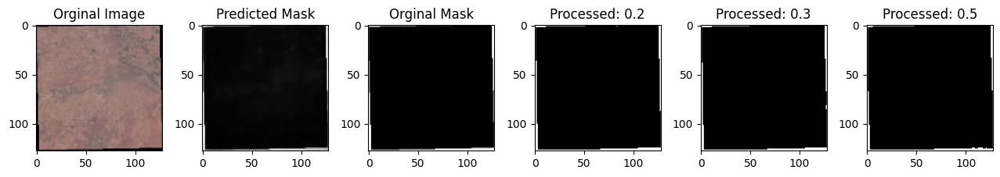

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7467 - loss: 0.2285 - val_accuracy: 0.7412 - val_loss: 0.2238
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7464 - loss: 0.23


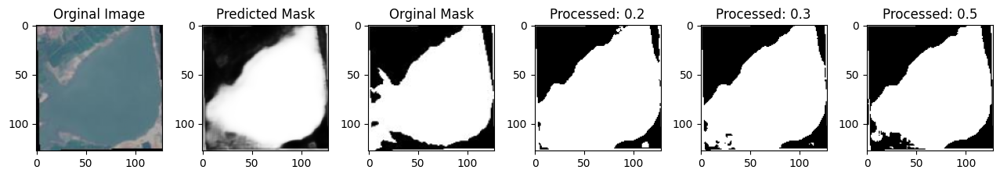

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7465 - loss: 0.2340 - val_accuracy: 0.7396 - val_loss: 0.2214
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7508 - loss: 0.22


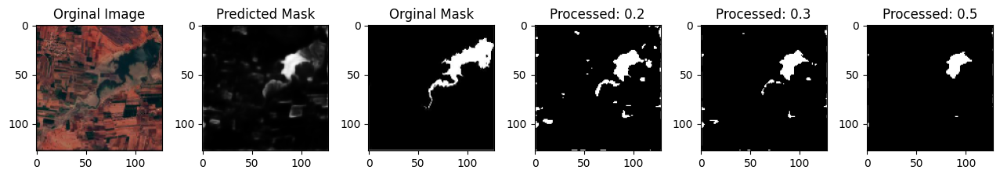

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7508 - loss: 0.2283 - val_accuracy: 0.7463 - val_loss: 0.2023
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7425 - loss: 0.24


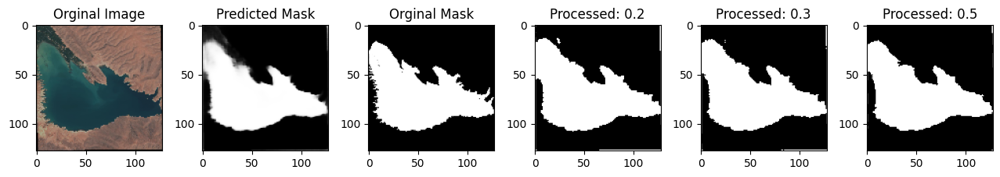

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7425 - loss: 0.2403 - val_accuracy: 0.7441 - val_loss: 0.2081
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7490 - loss: 0.24


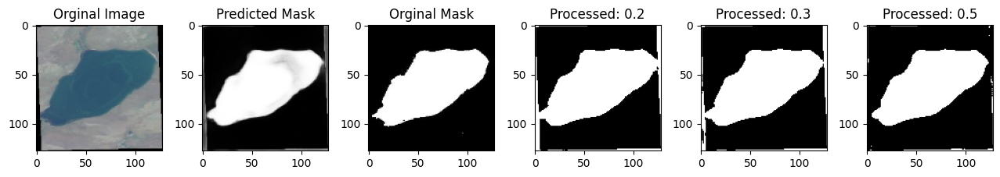

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7490 - loss: 0.2405 - val_accuracy: 0.7451 - val_loss: 0.2030
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7519 - loss: 0.22


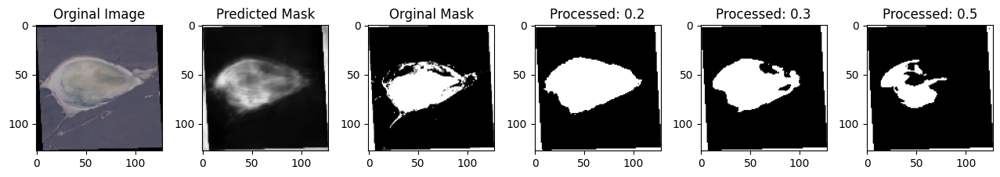

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7519 - loss: 0.2210 - val_accuracy: 0.7438 - val_loss: 0.2044
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7548 - loss: 0.22


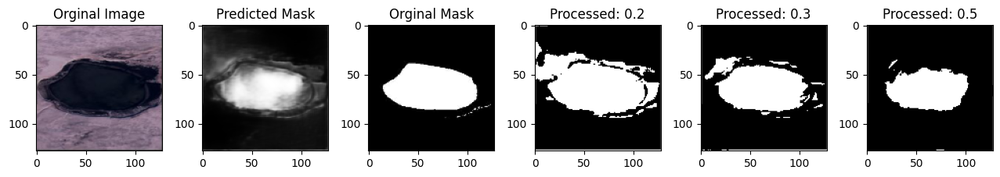

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7547 - loss: 0.2224 - val_accuracy: 0.7434 - val_loss: 0.2135
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7521 - loss: 0.22


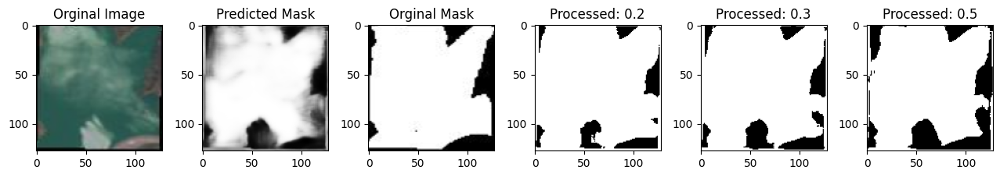

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7521 - loss: 0.2265 - val_accuracy: 0.7413 - val_loss: 0.2268
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7532 - loss: 0.22


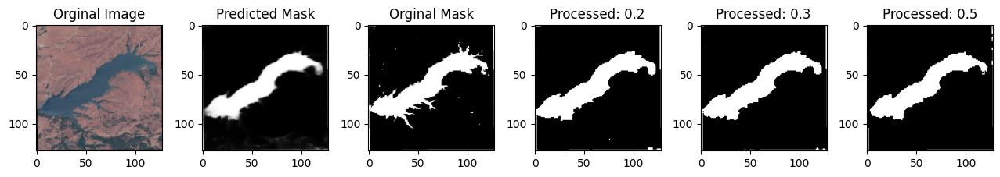

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7532 - loss: 0.2217 - val_accuracy: 0.7433 - val_loss: 0.2200
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7490 - loss: 0.22


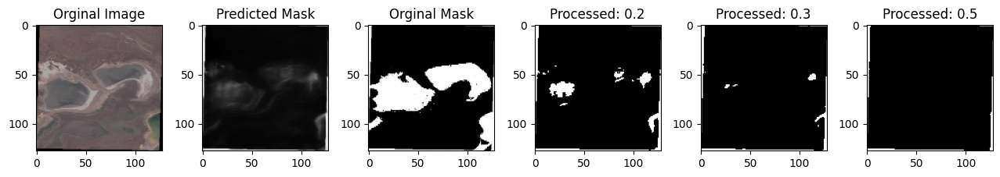

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7491 - loss: 0.2254 - val_accuracy: 0.7427 - val_loss: 0.2218
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7581 - loss: 0.215


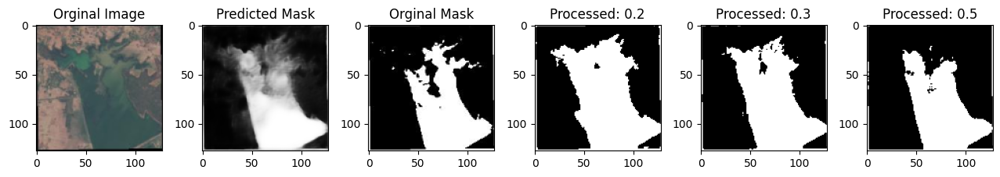

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7581 - loss: 0.2156 - val_accuracy: 0.7429 - val_loss: 0.2107
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7565 - loss: 0.215


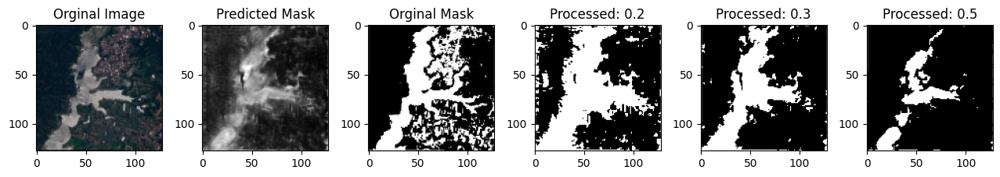

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7564 - loss: 0.2150 - val_accuracy: 0.7254 - val_loss: 0.2904
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7540 - loss: 0.22


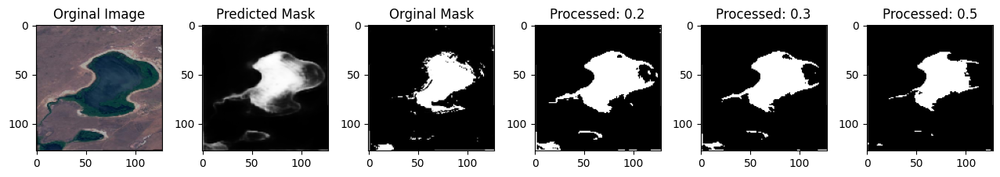

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7540 - loss: 0.2222 - val_accuracy: 0.7437 - val_loss: 0.2121
Epoch 53/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7514 - loss: 0.22


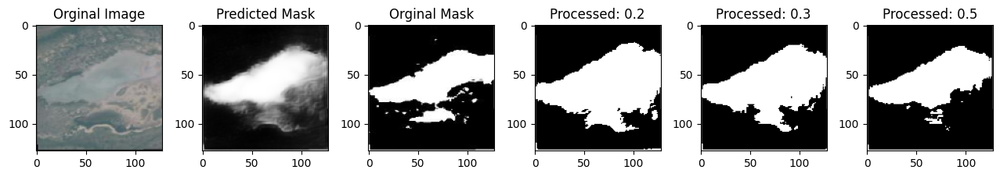

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7514 - loss: 0.2200 - val_accuracy: 0.7410 - val_loss: 0.2123
Epoch 54/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7529 - loss: 0.21


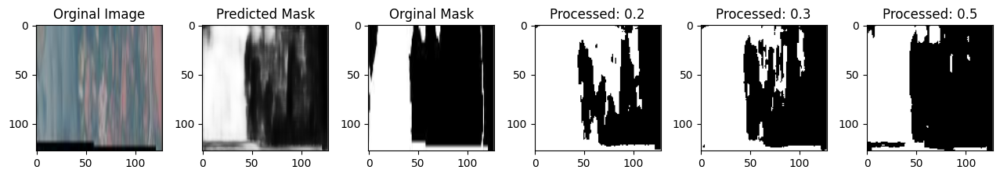

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7529 - loss: 0.2179 - val_accuracy: 0.7438 - val_loss: 0.2190
Epoch 55/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7557 - loss: 0.21


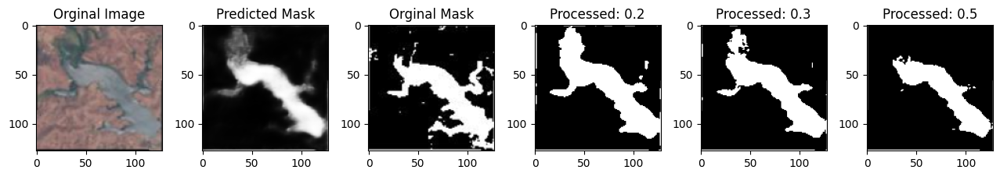

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7556 - loss: 0.2123 - val_accuracy: 0.7464 - val_loss: 0.2028
Epoch 56/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7578 - loss: 0.20


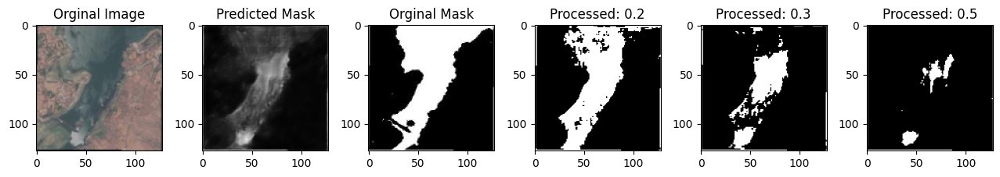

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7578 - loss: 0.2084 - val_accuracy: 0.7471 - val_loss: 0.2059
Epoch 57/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7568 - loss: 0.21


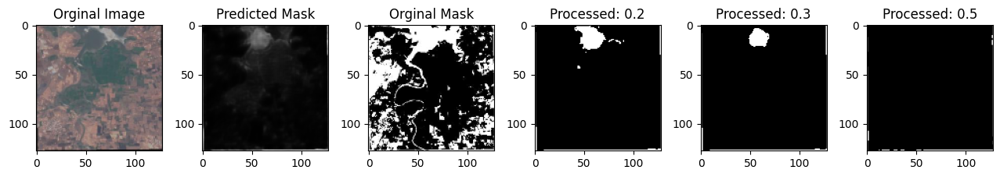

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7568 - loss: 0.2176 - val_accuracy: 0.7339 - val_loss: 0.2329
Epoch 58/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7459 - loss: 0.23


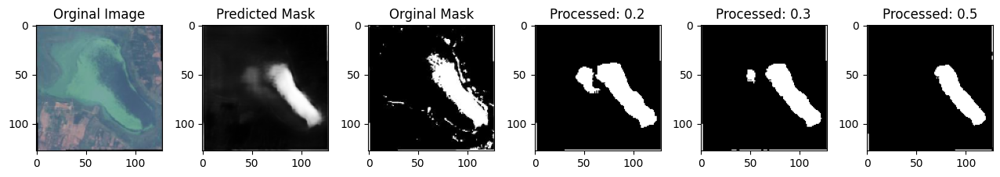

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7458 - loss: 0.2372 - val_accuracy: 0.7236 - val_loss: 0.3292
Epoch 59/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7434 - loss: 0.25


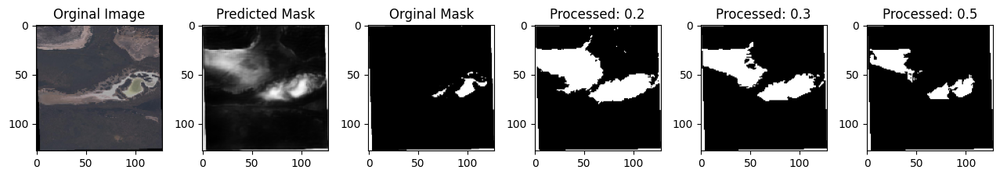

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7434 - loss: 0.2507 - val_accuracy: 0.7201 - val_loss: 0.2921
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7475 - loss: 0.23


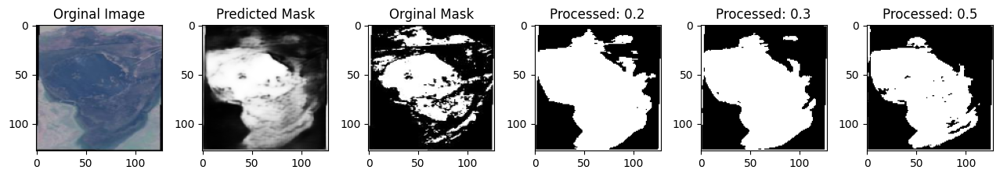

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 43ms/step - accuracy: 0.7475 - loss: 0.2305 - val_accuracy: 0.7377 - val_loss: 0.2301
Epoch 61/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7505 - loss: 0.22


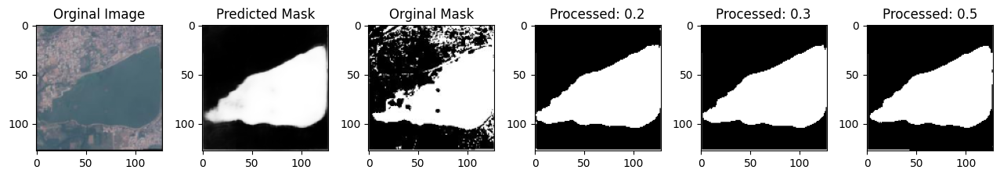

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7505 - loss: 0.2254 - val_accuracy: 0.7414 - val_loss: 0.2261
Epoch 62/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7508 - loss: 0.21


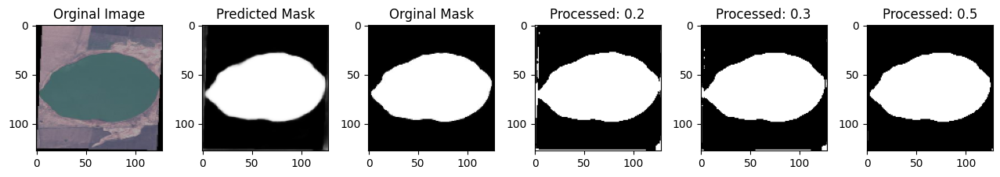

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7508 - loss: 0.2191 - val_accuracy: 0.7502 - val_loss: 0.2013
Epoch 63/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7576 - loss: 0.21


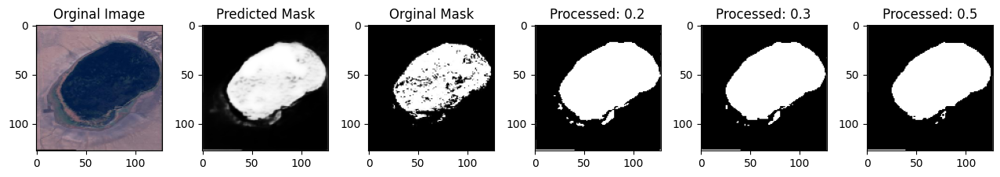

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7575 - loss: 0.2146 - val_accuracy: 0.7358 - val_loss: 0.2282
Epoch 64/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7589 - loss: 0.21


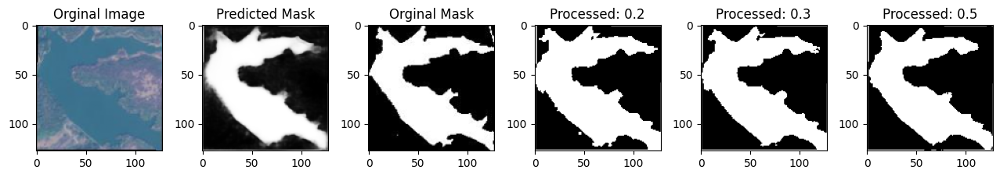

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7588 - loss: 0.2162 - val_accuracy: 0.7472 - val_loss: 0.2127
Epoch 65/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7521 - loss: 0.21


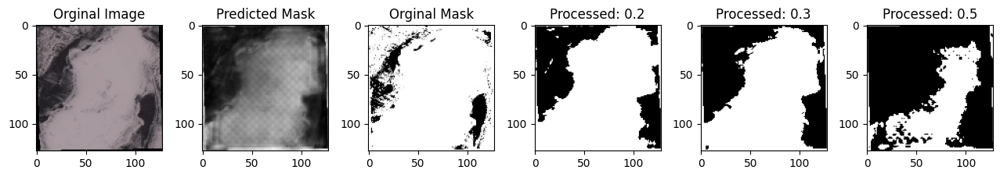

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7521 - loss: 0.2186 - val_accuracy: 0.7404 - val_loss: 0.2107
Epoch 66/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7484 - loss: 0.229


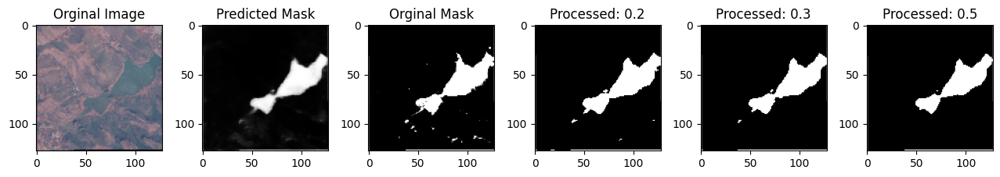

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7485 - loss: 0.2295 - val_accuracy: 0.7431 - val_loss: 0.2061
Epoch 67/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7538 - loss: 0.21


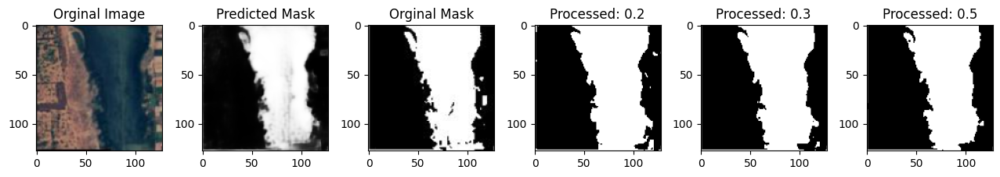

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7538 - loss: 0.2144 - val_accuracy: 0.7472 - val_loss: 0.1985
Epoch 68/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7575 - loss: 0.20


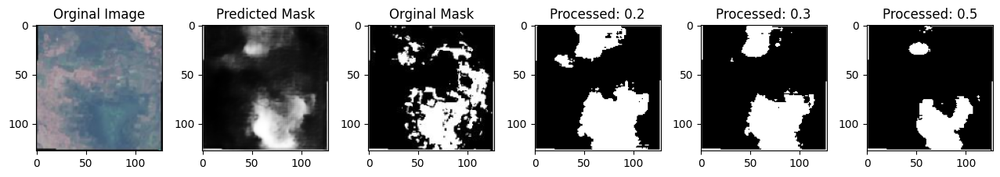

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7575 - loss: 0.2096 - val_accuracy: 0.7491 - val_loss: 0.1976
Epoch 69/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7570 - loss: 0.20


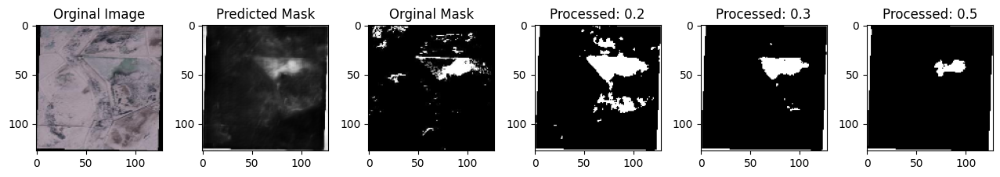

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7569 - loss: 0.2098 - val_accuracy: 0.7480 - val_loss: 0.2014
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7568 - loss: 0.21


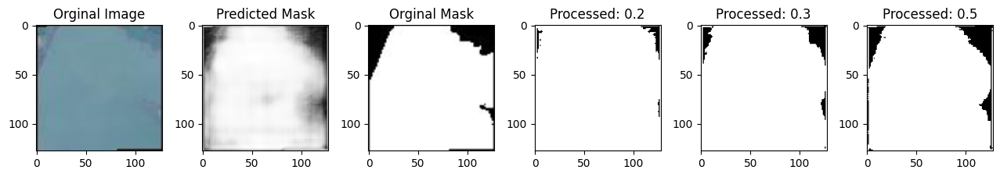

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7568 - loss: 0.2130 - val_accuracy: 0.7449 - val_loss: 0.2072
Epoch 71/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7590 - loss: 0.20


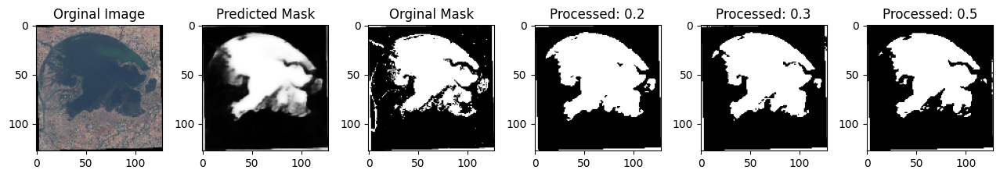

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7590 - loss: 0.2065 - val_accuracy: 0.7432 - val_loss: 0.2150
Epoch 72/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7575 - loss: 0.20


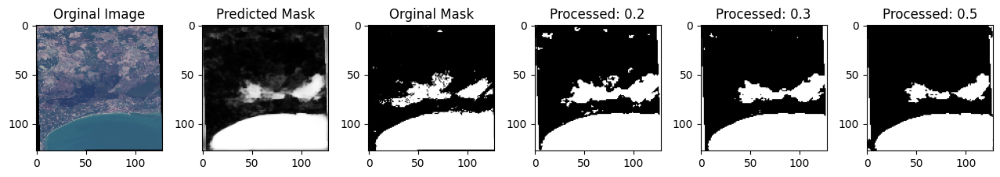

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7575 - loss: 0.2018 - val_accuracy: 0.7502 - val_loss: 0.1926
Epoch 73/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7577 - loss: 0.20


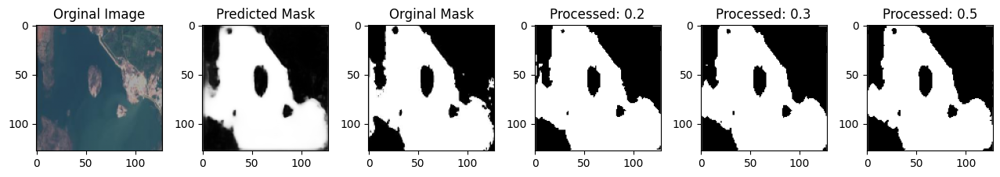

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7577 - loss: 0.2019 - val_accuracy: 0.7432 - val_loss: 0.2071
Epoch 74/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7581 - loss: 0.21


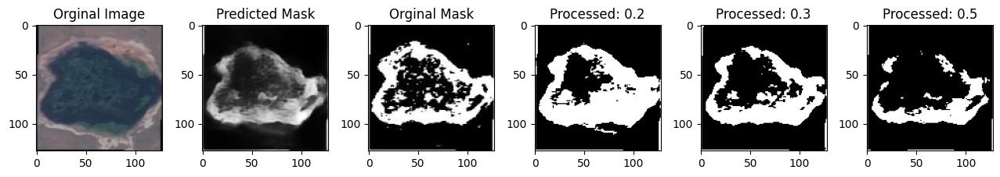

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7581 - loss: 0.2136 - val_accuracy: 0.7447 - val_loss: 0.2192
Epoch 75/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7597 - loss: 0.20


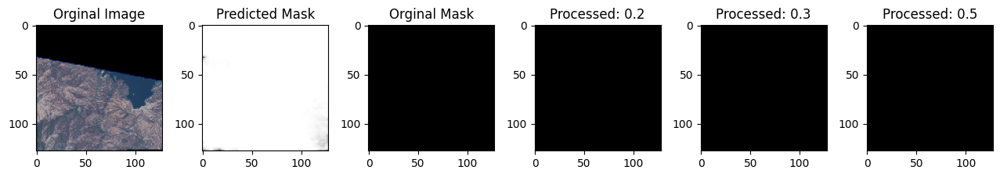

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7597 - loss: 0.2038 - val_accuracy: 0.7455 - val_loss: 0.2062
Epoch 76/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7534 - loss: 0.21


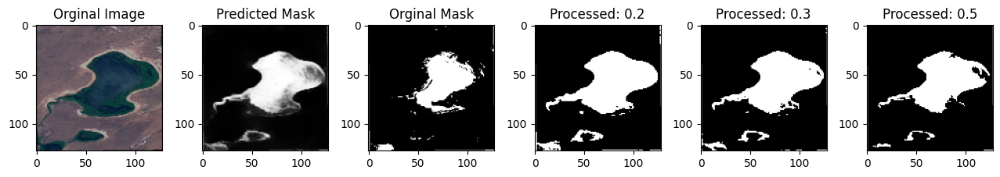

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7534 - loss: 0.2118 - val_accuracy: 0.7476 - val_loss: 0.1988
Epoch 77/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7594 - loss: 0.20


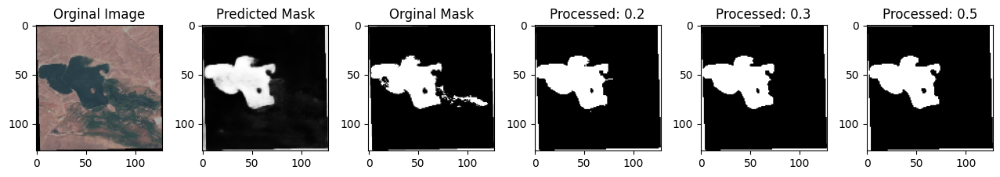

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7594 - loss: 0.2011 - val_accuracy: 0.7474 - val_loss: 0.1947
Epoch 78/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7620 - loss: 0.19


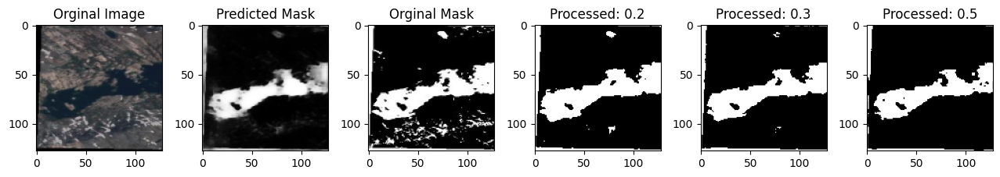

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.7620 - loss: 0.1963 - val_accuracy: 0.7425 - val_loss: 0.2154
Epoch 79/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7563 - loss: 0.206


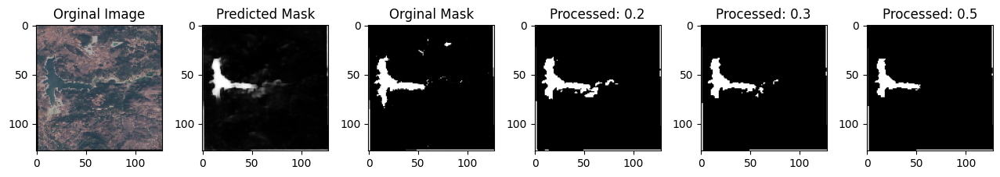

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7563 - loss: 0.2064 - val_accuracy: 0.7453 - val_loss: 0.2315
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7680 - loss: 0.19


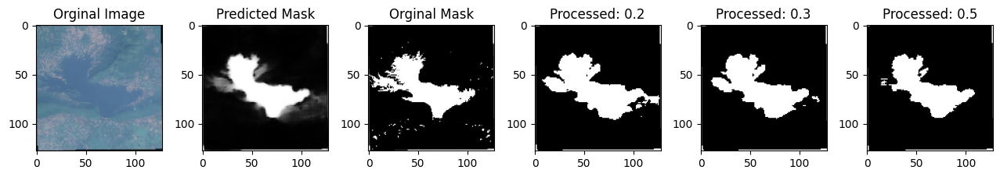

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7679 - loss: 0.1921 - val_accuracy: 0.7422 - val_loss: 0.2091
Epoch 81/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7478 - loss: 0.22


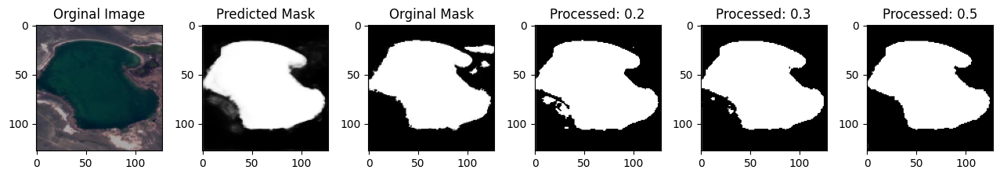

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7478 - loss: 0.2284 - val_accuracy: 0.7483 - val_loss: 0.2009
Epoch 82/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7461 - loss: 0.22


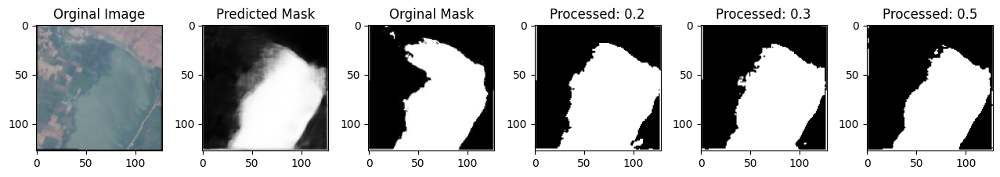

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7463 - loss: 0.2218 - val_accuracy: 0.7433 - val_loss: 0.2122
Epoch 83/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7555 - loss: 0.20


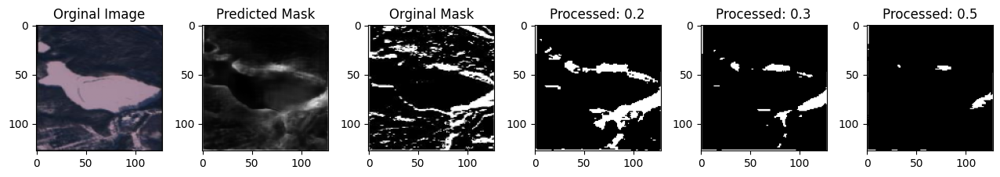

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7556 - loss: 0.2075 - val_accuracy: 0.7486 - val_loss: 0.1955
Epoch 84/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7643 - loss: 0.19


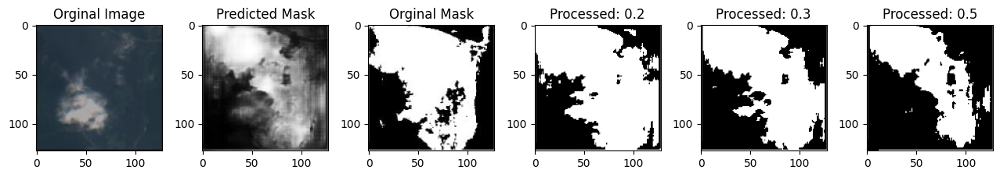

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7643 - loss: 0.1955 - val_accuracy: 0.7498 - val_loss: 0.1843
Epoch 85/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7619 - loss: 0.19


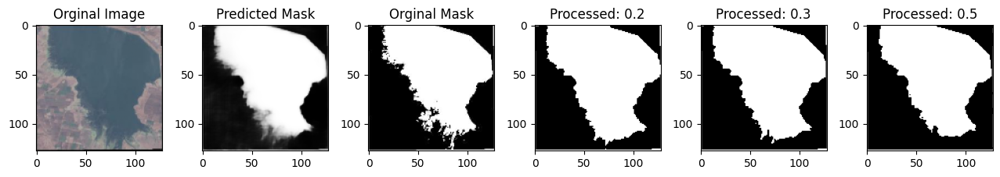

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7619 - loss: 0.1914 - val_accuracy: 0.7491 - val_loss: 0.1945
Epoch 86/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7607 - loss: 0.19


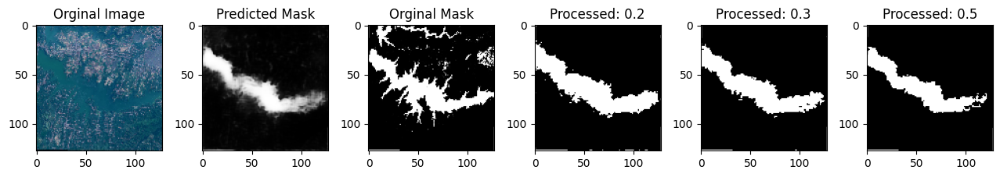

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7607 - loss: 0.1913 - val_accuracy: 0.7516 - val_loss: 0.1908
Epoch 87/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7595 - loss: 0.20


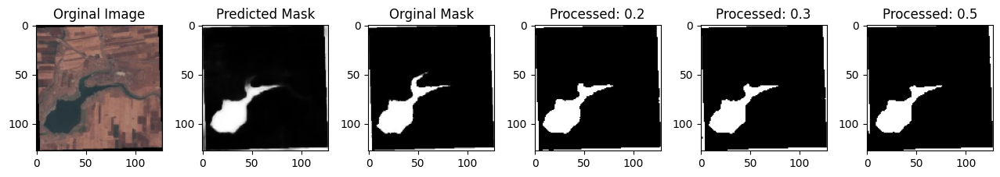

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7595 - loss: 0.2023 - val_accuracy: 0.7508 - val_loss: 0.1846
Epoch 88/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7560 - loss: 0.199


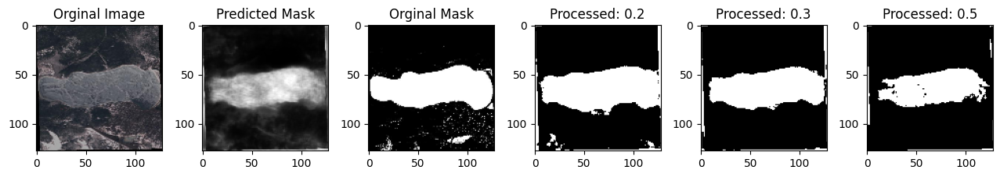

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7560 - loss: 0.1989 - val_accuracy: 0.7528 - val_loss: 0.1872
Epoch 89/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7609 - loss: 0.19


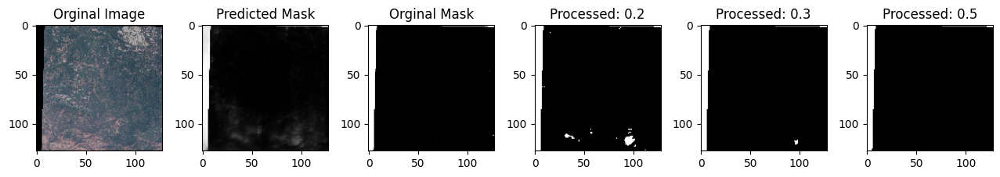

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7609 - loss: 0.1939 - val_accuracy: 0.7455 - val_loss: 0.2127
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7544 - loss: 0.21


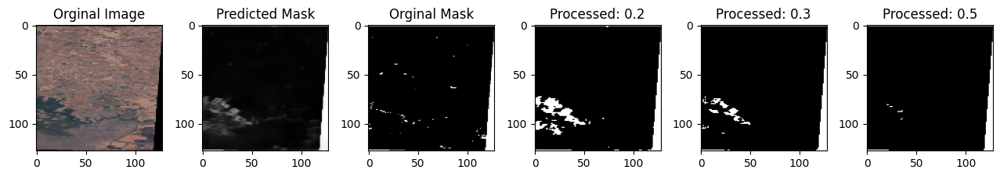

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7545 - loss: 0.2169 - val_accuracy: 0.7473 - val_loss: 0.2061
Epoch 91/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7565 - loss: 0.22


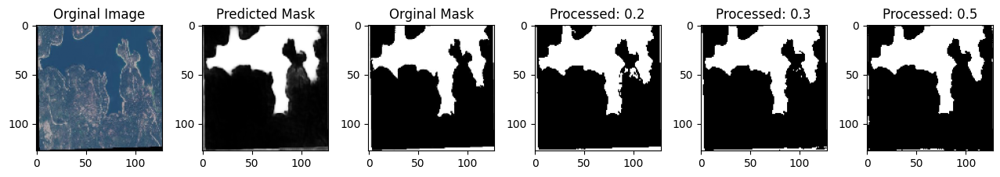

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - accuracy: 0.7564 - loss: 0.2213 - val_accuracy: 0.7518 - val_loss: 0.1938
Epoch 92/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7533 - loss: 0.22


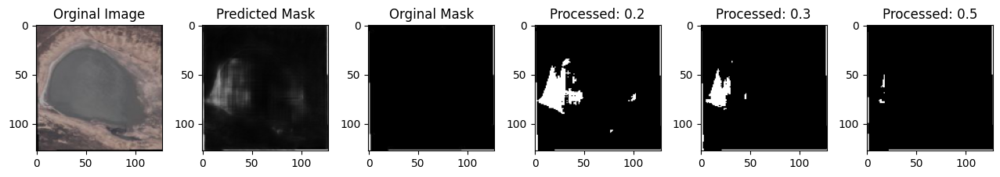

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 43ms/step - accuracy: 0.7533 - loss: 0.2231 - val_accuracy: 0.7502 - val_loss: 0.1915
Epoch 93/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7579 - loss: 0.21


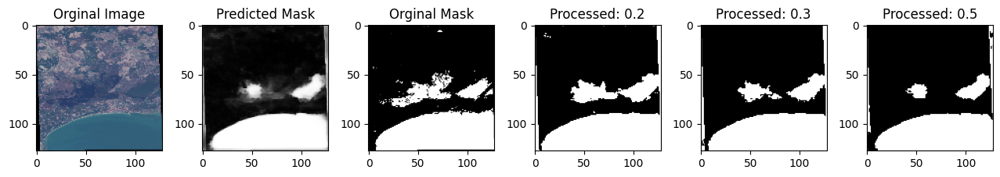

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7579 - loss: 0.2109 - val_accuracy: 0.7493 - val_loss: 0.1902
Epoch 94/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7590 - loss: 0.214


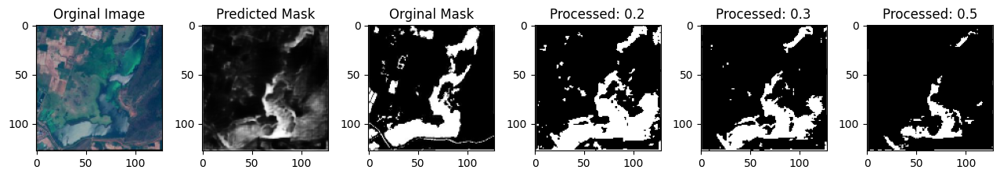

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7589 - loss: 0.2146 - val_accuracy: 0.7504 - val_loss: 0.1961
Epoch 95/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7571 - loss: 0.20


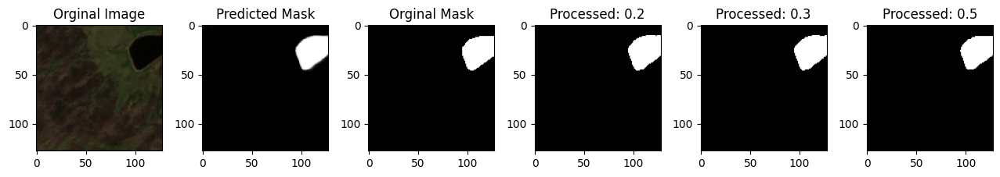

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7571 - loss: 0.2079 - val_accuracy: 0.7481 - val_loss: 0.2040
Epoch 96/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7645 - loss: 0.195


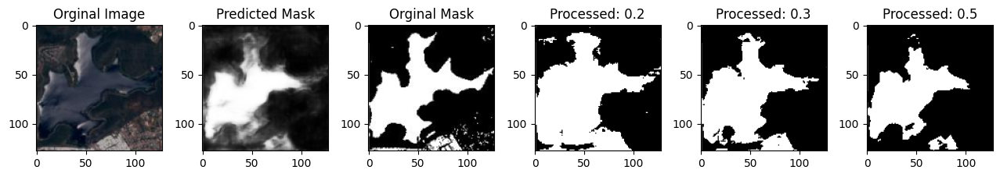

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7644 - loss: 0.1952 - val_accuracy: 0.7478 - val_loss: 0.2005
Epoch 97/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7627 - loss: 0.18


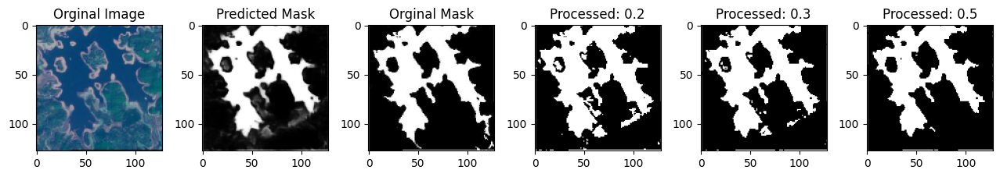

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.7627 - loss: 0.1862 - val_accuracy: 0.7480 - val_loss: 0.1993
Epoch 98/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7593 - loss: 0.194


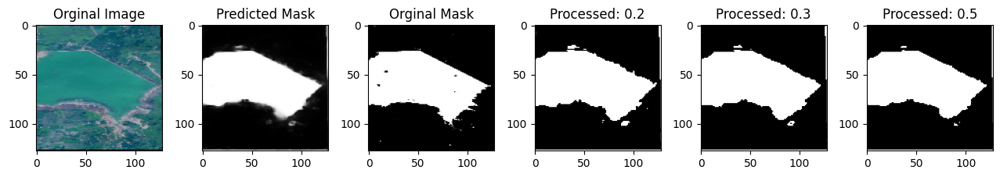

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 43ms/step - accuracy: 0.7593 - loss: 0.1949 - val_accuracy: 0.7484 - val_loss: 0.2003
Epoch 99/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7650 - loss: 0.18


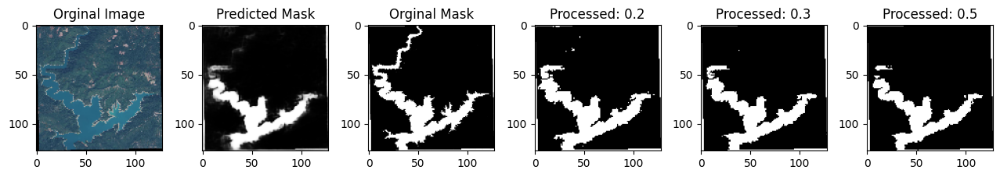

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7650 - loss: 0.1847 - val_accuracy: 0.7452 - val_loss: 0.2136
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7584 - loss: 0.19


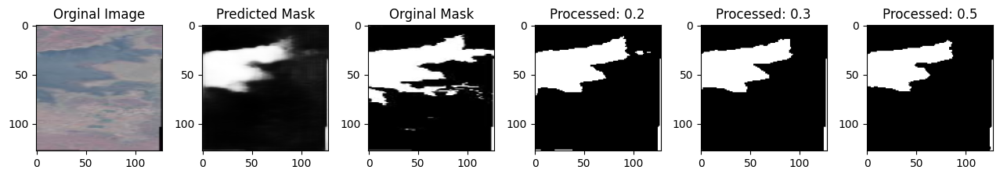

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7585 - loss: 0.1900 - val_accuracy: 0.7487 - val_loss: 0.1895


In [22]:
# Training
epochs = 100
batch_size = 32

history = model.fit(images_train, mask_train,
                    validation_data=[images_test, mask_test], 
                    epochs=epochs,
                    callbacks=[ShowProgress()],
                    batch_size=batch_size)

In [24]:
from datetime import datetime

# Get the current date and time
current_time = datetime.now().strftime('%Y-%m-%d_%H-%M-%S')

# Save the model with the current date and time in the filename
model.save(f'../models/{current_time}.keras')

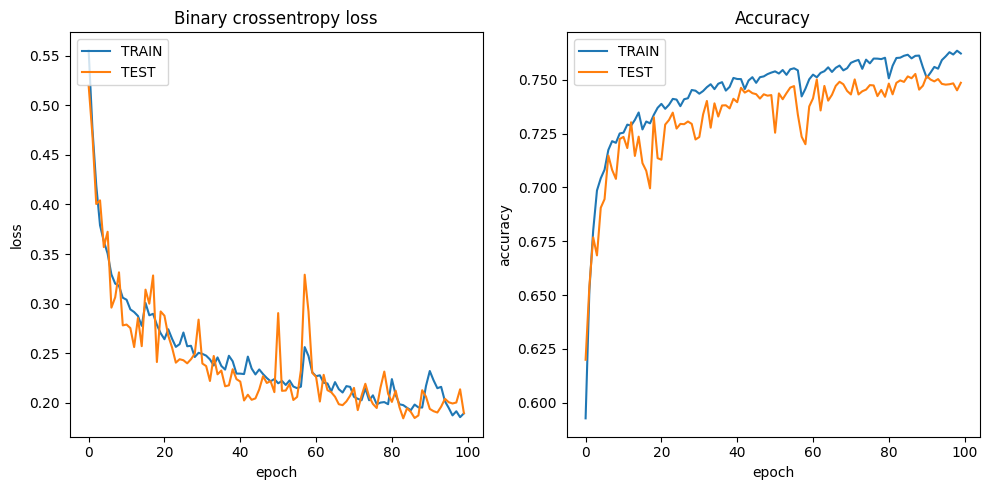

In [26]:
plt.figure(figsize=(10,5))

# Plot loss for each epoch
plt.subplot(1,2,1)
plt.plot(history.history['loss'], label="Train loss")
plt.plot(history.history['val_loss'], label="Test loss")
plt.title('Binary crossentropy loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

# Plot accuracy for each epoch
plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label="Train accuracy")
plt.plot(history.history['val_accuracy'], label="Test accuracy")
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

plt.tight_layout()
plt.show()

In [27]:
# Make predictions
predictions = model.predict(images_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


In [28]:
def plot_results(threshold=0.5):
    k = np.random.randint(len(images_test))
    original_image = images_test[k]
    mask = mask_test[k].reshape(128,128)
    predicted_mask = predictions[k].reshape(128,128)
    threshold_mask = mask_threshold(predicted_mask, threshold=threshold)

    plt.figure(figsize=(15,5))

    plt.subplot(1,4,1)
    plt.imshow(original_image);plt.title('Orginal Image')

    plt.subplot(1,4,2)
    plt.imshow(mask, cmap='gray');plt.title('Original Mask')

    plt.subplot(1,4,3)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,4,4)
    plt.imshow(threshold_mask, cmap='gray');plt.title(f'Predicted Mask with cutoff={threshold}')

    plt.tight_layout()
    plt.show()

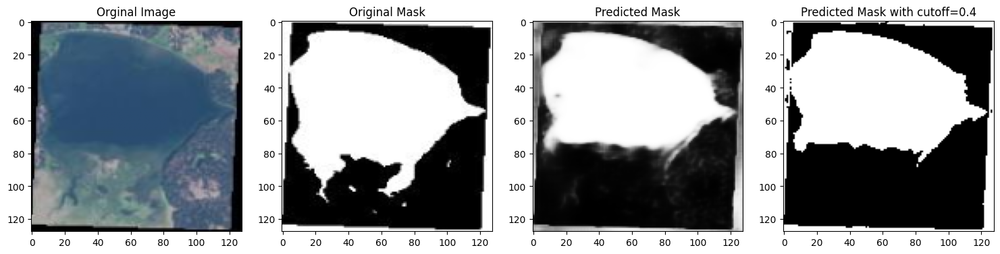

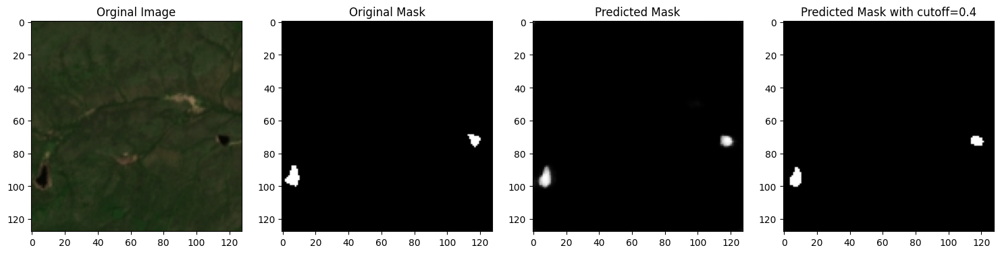

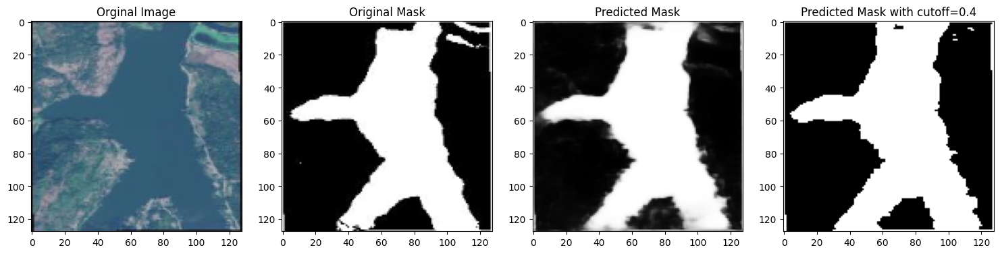

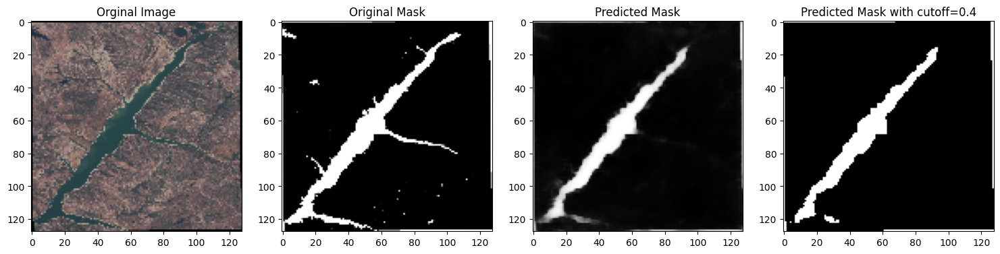

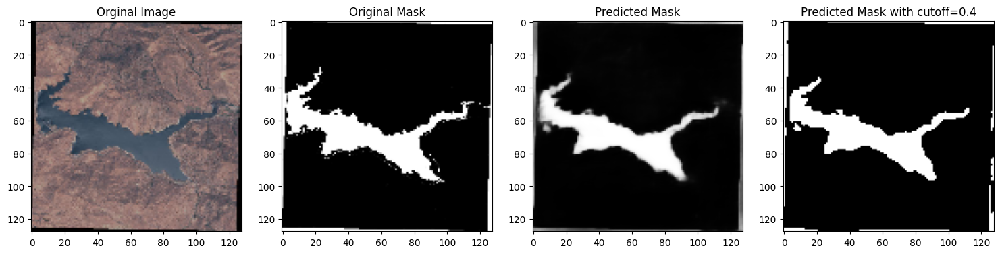

...

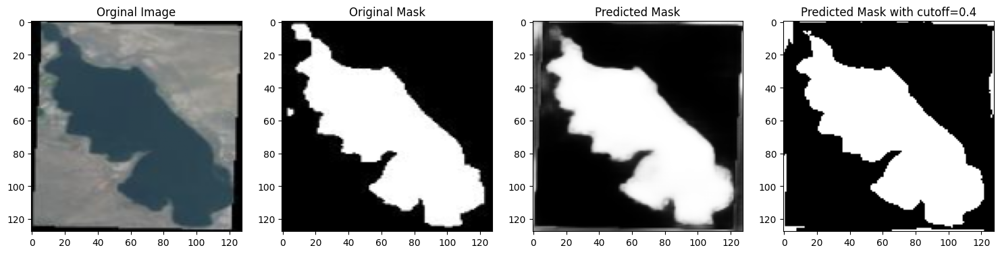

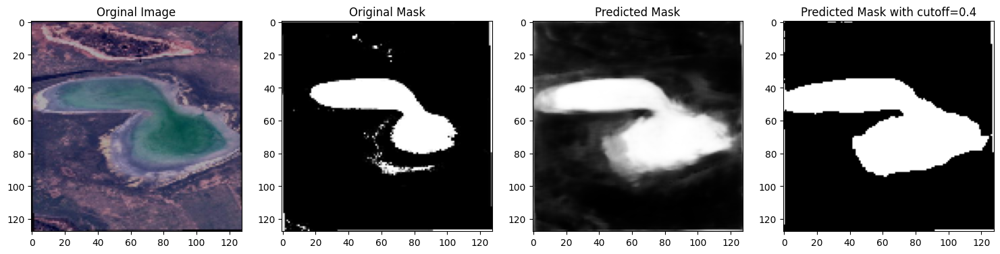

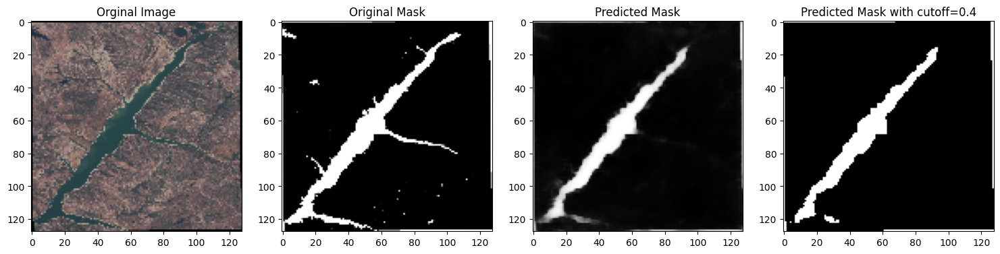

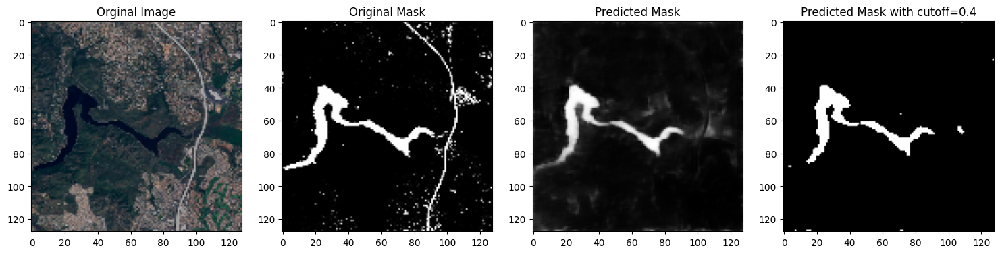

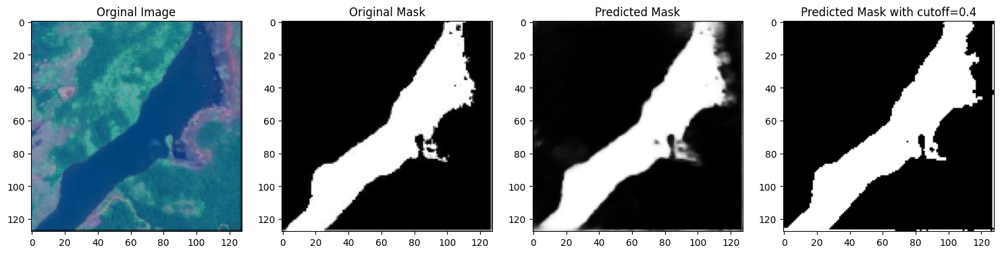

In [29]:
# Plot results on test data
for i in range(40):
  plot_results(threshold=0.4)